In [1]:

import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import MultipleLocator
import folium 
from folium.plugins import HeatMap
from datetime import datetime
from folium.plugins import HeatMap
from sklearn.cluster import KMeans
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.metrics import silhouette_score


In [21]:
from matplotlib import rcParams
rcParams['font.family'] = 'Arial'

### Model.py functions

In [2]:
def coord_location_array(df, lat_col, long_col):
    location_lst = df[[lat_col, long_col]]
    array = location_lst.to_numpy()
    return array

def kmeans_model(array, n_clust=8):
    kmeans = KMeans(n_clusters=n_clust)
    kmeans.fit(array)
    return kmeans

def calc_silhouette_score(nclust, array):
    kmeans = KMeans(n_clusters = nclust, 
                init = 'random', 
                n_init = 10, 
                max_iter = 100, 
                n_jobs = -1)
    kmeans.fit(array)
    sil_avg = silhouette_score(array, kmeans.labels_)
    return sil_avg

def silhouette_plot(ax, sil_score_lst, color, label, title):
    ax.plot(range(2,10), sil_score_lst, 'o--', c = color, label=label)
    ax.set_xlabel('K', fontsize=18)
    ax.set_ylabel('Silhouette Score', fontsize=18)
    ax.set_title(title, fontsize=20)
    ax.legend()

def kmeans_scatter_plot(ax, cluster_array, color, size, label, title):
    ax.scatter(cluster_array[:,0], cluster_array[:,1], s=size, 
                color=color, label=label)
    ax.set_xlabel('Latitude', fontsize=16)
    ax.set_ylabel('Longtitude', fontsize=16)
    ax.set_title(title, fontsize=20)
    ax.legend()

def cluster_center_df(cluster_array, col_lst):
    df = pd.DataFrame(cluster_array, columns=col_lst)
    name = ['cluster' + str(idx+1) for idx in range(0,len(df))]
    df['name'] = name
    return df

def hierarchical_cluster_model(dist_metric, link_method, array):
    distmetric = dist_metric
    linkmethod = link_method
    dist = pdist(array, metric=distmetric)
    clust = linkage(dist, method=linkmethod)
    return clust

def dendrogram_plot(cluster, ax, level_num, trunc_mode, color_thresh, title):
    dendrogram(cluster, ax, p=level_num, truncate_mode=trunc_mode, color_threshold=color_thresh)
    plt.xticks(fontsize-12)
    plt.title(title, fontsize=24)

### Scooter_clean.py functions

In [3]:
def load_data(filepath):
        df = pd.read_csv(filepath)
        return df

def drop_cols_update_names(df, col_lst):
    df.drop(columns=col_lst, inplace=True)
    df.columns = df.columns.str.replace(' ', '_')
    return df

def drop_nans(df):
    return df.dropna(inplace=True)

def cols_to_datetime(df, col_lst):
    for col in col_lst:
        df[col] = pd.to_datetime(df[col])
    return df

def add_weekday_column(df, new_col, date_col):
    df[new_col] = df[date_col].dt.weekday
    return df

def add_hour_column(df, new_col, date_col):
    df[new_col] = df[date_col].dt.hour
    return df

def change_col_units(df, col, divisor):
    df[col] = df[col].apply(lambda x: x/divisor)
    return df

def filter_out_bad_data(df, col_lst, threshold_lst):
    for col, thresh in zip(col_lst, threshold_lst):
        if thresh < 20:
            df = df[df[col] > thresh]
        else:
            df = df[df[col] < thresh]
    df.reset_index(drop=True)
    return df

def clean_dataframe(df, drop_col_lst, date_col_lst, day_col, hour_col, date_col, 
                        unit_col_1, unit_col_2, div_1, div_2, filter_col_lst, thresh_lst):

    df = drop_cols_update_names(df, drop_col_lst)
    drop_nans(df)
    df = cols_to_datetime(df, date_col_lst)
    df = add_weekday_column(df, day_col, date_col)
    df = add_hour_column(df, hour_col, date_col) 
    df = change_col_units(df, unit_col_1, div_1)
    df = change_col_units(df, unit_col_2, div_2)
    df = filter_out_bad_data(df, filter_col_lst, thresh_lst)
    return df.reset_index(drop=True)

def data_snapshot(df, col, low_end, high_end):
    df = df[df[col] > low_end]
    df = df[df[col] <= high_end]
    return df.reset_index(drop=True)

def save_dataframe_to_csv(df, filepath):
    return df.to_csv(filepath)

### Plotting_mapping.py functions

In [23]:
def histogram_of_column(df, col, ax, color, title, x_label, x_tick_loc, y_tick_loc, x_low, x_high):
    df[col].hist(color=color, grid=False, bins=30)
    ax.set_title(title, fontsize=20)
    ax.set_xlabel(x_label, fontsize=16)
    ax.set_ylabel('Frequency', fontsize=16)
    ax.tick_params(axis='x', which='minor', length=7, width=1)
    ax.tick_params(axis='x', which='major', length=10, width=1, labelsize='medium')
    ax.tick_params(axis='y', which='minor', length=5, width=1)
    ax.tick_params(axis='y', which='major', length=7, width=1, labelsize='medium')
    ax.xaxis.set_minor_locator(MultipleLocator(x_tick_loc))
    ax.yaxis.set_minor_locator(MultipleLocator(y_tick_loc))   
    ax.set_xlim(x_low, x_high)

def bar_chart(df, col, ax, color, label_lst, title, x_label):
    series = df[col].value_counts().sort_index()

    series.plot(kind='bar', color=color)
    ax.set_title(title, fontsize=30, fontweight='bold')
    ax.set_xlabel(x_label, fontsize=20, fontweight='bold')
    ax.set_ylabel('Frequency', fontsize=20, fontweight='bold')
    if label_lst == None:
        plt.xticks(rotation=45, fontsize=18)
    else:
        ax.set_xticklabels(labels=label_lst, rotation=45, fontsize=18, ha='right')

def location_heat_map(df, lat_col, long_col, map_name):
    heat_map = folium.FeatureGroup(name = 'heat_map')
    heat_map.add_child( HeatMap( list(zip(df[lat_col].values,
                                        df[long_col].values)),
                                  name=map_name, max_val=float(60),
                                  min_opacity=0.2, radius=5.5, 
                                  blur=3.5, max_zoom=1))
    return heat_map

def image_file(filepath):
    return plt.savefig(filepath, transparent=False, bbox_inches='tight', format='svg', dpi=1200)

def map_html_file(map_name, filepath):
    return map_name.save(filepath)

In [6]:
df = pd.read_csv('data/small_scooter.csv')
df.drop(columns='Unnamed: 0', inplace=True)
df.head()

,Trip_ID,Start_Time,End_Time,Trip_Distance,Trip_Duration,Accuracy,Start_Centroid_Latitude,Start_Centroid_Longitude,End_Centroid_Latitude,End_Centroid_Longitude,Day_of_Week,Time_of_Day
0,11d42b99-e839-346c-11d4-2b99e839346c,2019-06-24 19:00:00,2019-06-24 19:00:00,0.569919,5.983333,10,41.894101,-87.763112,41.894101,-87.763112,0,19
1,c46c5b1f-d7a1-5c11-96b6-bb8bfa2d4fa3,2019-06-21 18:00:00,2019-06-21 19:00:00,0.469857,46.833333,0,41.953582,-87.723452,41.953582,-87.723452,4,18
2,3ad30b66-b615-404b-ada2-92cfb30dd32b,2019-06-21 21:00:00,2019-06-21 21:00:00,0.824736,4.000000,152,41.953582,-87.723452,41.953582,-87.723452,4,21
3,8574e87e-d881-4468-bf79-f7e62f268f4d,2019-06-21 18:00:00,2019-06-21 19:00:00,1.694842,22.416667,10,41.953582,-87.723452,41.953582,-87.723452,4,18
4,9b79b345-1492-40f4-85a6-fee83c5a6ffc,2019-06-26 18:00:00,2019-06-26 18:00:00,0.991920,5.316667,152,41.953582,-87.723452,41.953582,-87.723452,2,18


In [7]:
df = cols_to_datetime(df, ['Start_Time', 'End_Time'])
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58009 entries, 0 to 58008
Data columns (total 12 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   Trip_ID                   58009 non-null  object        
 1   Start_Time                58009 non-null  datetime64[ns]
 2   End_Time                  58009 non-null  datetime64[ns]
 3   Trip_Distance             58009 non-null  float64       
 4   Trip_Duration             58009 non-null  float64       
 5   Accuracy                  58009 non-null  int64         
 6   Start_Centroid_Latitude   58009 non-null  float64       
 7   Start_Centroid_Longitude  58009 non-null  float64       
 8   End_Centroid_Latitude     58009 non-null  float64       
 9   End_Centroid_Longitude    58009 non-null  float64       
 10  Day_of_Week               58009 non-null  int64         
 11  Time_of_Day               58009 non-null  int64         
dtypes: datetime64[ns](

### Create new dataframe with 8 features and redo kmeans and hierarchical clustering

In [ ]:
df1 = df[['Trip_Distance', 'Trip_Duration', 'Start_Centroid_Latitude', 'Start_Centroid_Longitude', 
          'End_Centroid_Latitude', 'End_Centroid_Longitude', 'Day_of_Week', 'Time_of_Day']]
df1.head()

In [ ]:
first_kmeans = kmeans_model(df1)
print('cluster centers:{}'.format(first_kmeans.cluster_centers_))

In [ ]:
first_sil_scores = [calc_silhouette_score(i, df1) for i in range(2,10)]

In [ ]:
fig, ax = plt.subplots(figsize=(10,6))
silhouette_plot(ax, first_sil_scores, 'b', 'More Features', 
                    'Silhouette Score vs K - Scooter Rides')

In [ ]:
first_kmeans = kmeans_model(df1, n_clust=2)
print('cluster centers:{}'.format(first_kmeans.cluster_centers_))

In [ ]:
first_kmeans = kmeans_model(df1, n_clust=3)
print('cluster centers:{}'.format(first_kmeans.cluster_centers_))

In [ ]:
df1.info()

In [ ]:
first_hier_clust = hierarchical_cluster_model('euclidean', 'complete',
                                                df1)

In [ ]:
first_hier_clust

In [ ]:
# fig, ax = plt.subplots(figsize=(24, 12))
# dendrogram_plot(first_hier_clust, ax, 6, 'level', 0.074, 'More Features Dendrogram')

fig, ax = plt.subplots(figsize=(24,12))
dendrogram(first_hier_clust, ax=ax, p=6, truncate_mode='level', color_threshold=60)
plt.xticks(fontsize=12)
plt.title('More Features Dendrogram', fontsize=24);



In [ ]:
first_hier_clust1 = hierarchical_cluster_model('cosine', 'complete',
                                                df1)

In [ ]:
fig, ax = plt.subplots(figsize=(24,12))
dendrogram(first_hier_clust1, ax=ax, p=6, truncate_mode='level', color_threshold=0.1)
plt.xticks(fontsize=12)
plt.title('More Features Dendrogram', fontsize=24);


### Another dataframe

In [ ]:
df2 = df1[['Start_Centroid_Latitude', 'Start_Centroid_Longitude', 
          'End_Centroid_Latitude', 'End_Centroid_Longitude', 'Day_of_Week', 'Time_of_Day']]
df2.head()

In [ ]:
second_kmeans = kmeans_model(df2)
print('cluster centers:{}'.format(second_kmeans.cluster_centers_))

In [ ]:
second_sil_scores = [calc_silhouette_score(i, df2) for i in range(2,10)]

In [ ]:
fig, ax = plt.subplots(figsize=(10,6))
silhouette_plot(ax, second_sil_scores, 'b', 'More Features', 
                    'Silhouette Score vs K - Scooter Rides')

In [ ]:
second_hier_clust = hierarchical_cluster_model('euclidean', 'complete',
                                                df2)

In [ ]:
fig, ax = plt.subplots(figsize=(24,12))
dendrogram(second_hier_clust, ax=ax, p=6, truncate_mode='level', color_threshold=8)
plt.xticks(fontsize=12)
plt.title('More Features Dendrogram', fontsize=24);

### And Another

In [ ]:
df3 = df1[['Trip_Distance', 'Start_Centroid_Latitude', 'Start_Centroid_Longitude', 
          'End_Centroid_Latitude', 'End_Centroid_Longitude', 'Day_of_Week', 'Time_of_Day']]
df3.head()

In [ ]:
third_kmeans = kmeans_model(df3)
print('cluster centers:{}'.format(third_kmeans.cluster_centers_))

In [ ]:
third_sil_scores = [calc_silhouette_score(i, df3) for i in range(2,10)]

In [ ]:
fig, ax = plt.subplots(figsize=(10,6))
silhouette_plot(ax, third_sil_scores, 'b', 'More Features', 
                    'Silhouette Score vs K - Scooter Rides')

In [ ]:
third_hier_clust = hierarchical_cluster_model('euclidean', 'complete',
                                                df3)

In [ ]:
fig, ax = plt.subplots(figsize=(24,12))
dendrogram(third_hier_clust, ax=ax, p=6, truncate_mode='level', color_threshold=16)
plt.xticks(fontsize=12)
plt.title('More Features Dendrogram', fontsize=24);

### And Another


In [8]:
df4 = df[['Trip_Distance', 'Trip_Duration', 'Start_Centroid_Latitude', 'Start_Centroid_Longitude', 
           'Day_of_Week', 'Time_of_Day']]
df4.head()
# [[  0.86172833   6.33345203  41.89850811 -87.68202525   3.02217214
#    15.30868523]
#  [  4.37490187  91.07847424  41.89707314 -87.7083582    3.23290787
#    15.94995577]
#  [  2.23134782  18.79403556  41.9014501  -87.69171184   3.28445306
#    16.0553142 ]
#  [  3.92803169 229.1941677   41.89119501 -87.69458118   3.17310087
#    15.37982565]
#  [  3.64583262  41.49385878  41.90068024 -87.70085826   3.32278545
#    16.20537891]]

,Trip_Distance,Trip_Duration,Start_Centroid_Latitude,Start_Centroid_Longitude,Day_of_Week,Time_of_Day
0,0.569919,5.983333,41.894101,-87.763112,0,19
1,0.469857,46.833333,41.953582,-87.723452,4,18
2,0.824736,4.000000,41.953582,-87.723452,4,21
3,1.694842,22.416667,41.953582,-87.723452,4,18
4,0.991920,5.316667,41.953582,-87.723452,2,18


In [ ]:
fourth_kmeans = kmeans_model(df4)
print('cluster centers:{}'.format(fourth_kmeans.cluster_centers_))

In [ ]:
fourth_sil_scores = [calc_silhouette_score(i, df4) for i in range(2,10)]

In [ ]:
fig, ax = plt.subplots(figsize=(10,6))
silhouette_plot(ax, fourth_sil_scores, 'b', 'More Features', 
                    'Silhouette Score vs K - Scooter Rides')

In [ ]:
fourth_kmeans = kmeans_model(df4, n_clust=2)
print('cluster centers:{}'.format(fourth_kmeans.cluster_centers_))

In [ ]:
fourth_kmeans = kmeans_model(df4, n_clust=3)
print('cluster centers:{}'.format(fourth_kmeans.cluster_centers_))

In [ ]:
df4.info()

In [22]:
fourth_hier_clust = hierarchical_cluster_model('euclidean', 'complete',
                                                df4)

findfont: Font family ['arial-narrow'] not found. Falling back to DejaVu Sans.


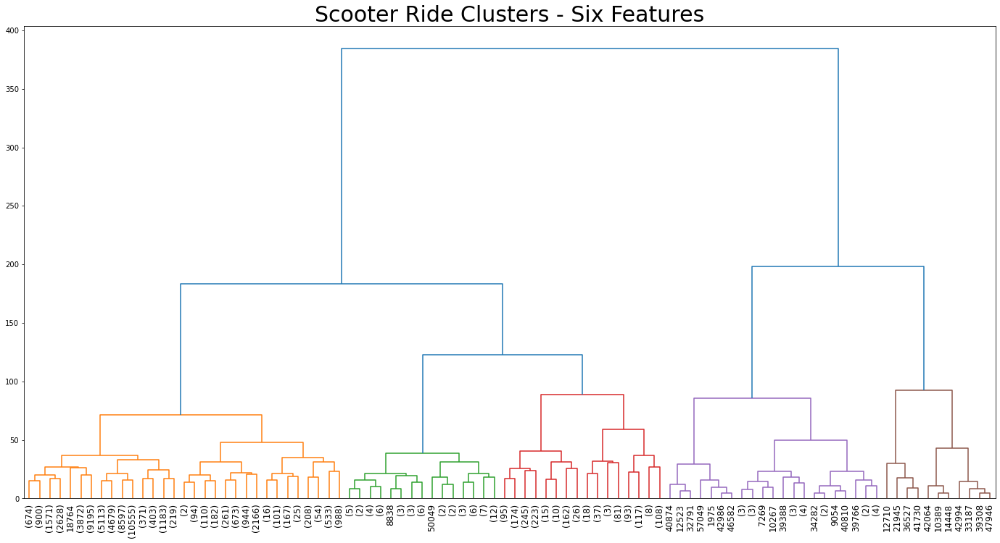

In [25]:
fig, ax = plt.subplots(figsize=(24,12))
dendrogram(fourth_hier_clust, ax=ax, p=6, truncate_mode='level', color_threshold=100)
plt.xticks(fontsize=12)
plt.title('Scooter Ride Clusters - Six Features', fontsize=30);
plt.savefig('images/five_clust_dend.png', transparent=False, bbox_inches='tight')

In [ ]:
fourth_kmeans = kmeans_model(df4, n_clust=5)
print('cluster centers:{}'.format(fourth_kmeans.cluster_centers_))

### New EDA plots for presentation

In [ ]:
scooter = load_data('data/2019_Scooter_pilot.csv')
scooter = clean_dataframe(df=scooter, 
                        drop_col_lst=['Start Census Tract', 'End Census Tract',
                        'Start Community Area Number', 'End Community Area Number', 
                        'Start Community Area Name', 'End Community Area Name', 
                        'Start Centroid Location', 'End Centroid Location'],
                        date_col_lst=['Start_Time', 'End_Time'],
                        day_col='Day_of_Week',
                        hour_col='Time_of_Day',
                        date_col='Start_Time',
                        unit_col_1='Trip_Distance',
                        div_1=1609,
                        unit_col_2='Trip_Duration',
                        div_2=60,
                        filter_col_lst=['Trip_Distance', 'Trip_Duration', 'Trip_Duration'],
                        thresh_lst=[25, 2, 400])

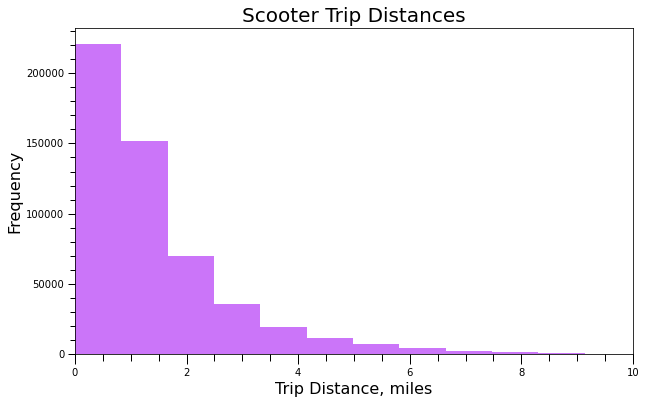

In [24]:
fig, ax = plt.subplots(figsize=(10,6))
histogram_of_column(clean, 'Trip_Distance', ax, '#CB75F9',
                    'Scooter Trip Distances', 
                    'Trip Distance, miles', 0.5, 10000, 0, 10)
plt.savefig('../images/dull_df_distance.svg', transparent=False, bbox_inches='tight', format='svg', dpi=1200)

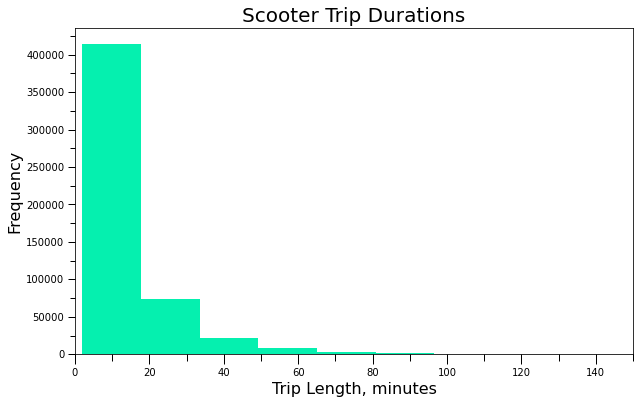

In [23]:
fig, ax = plt.subplots(figsize=(10,6))
histogram_of_column(clean, 'Trip_Duration', ax, '#05F0AF',
                    'Scooter Trip Durations', 
                    'Trip Length, minutes', 10, 25000, 0, 150 )
plt.savefig('../images/full_df_duration.svg', transparent=False, bbox_inches='tight', format='svg', dpi=1200)

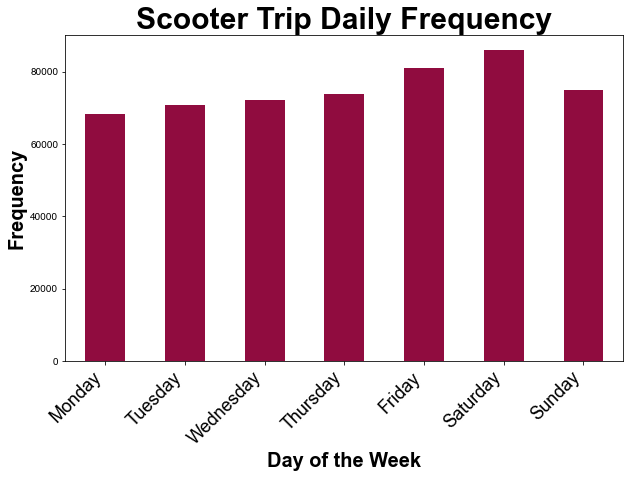

In [25]:
weekdays=['Monday', 'Tuesday', 'Wednesday', 'Thursday','Friday', 'Saturday', 'Sunday']
fig, ax = plt.subplots(figsize=(10,6))
bar_chart(clean, 'Day_of_Week', ax, '#900C3F', weekdays, 
            'Scooter Trip Daily Frequency', 'Day of the Week')
# plt.savefig('../images/full_df_dayweek.svg', transparent=False, bbox_inches='tight', format='svg', dpi=1200)
# # image_file('images/fulldf_day_of_week_bar.svg')
plt.savefig('../images/fulldf_day_of_week_bar.png', transparent=False, bbox_inches='tight')

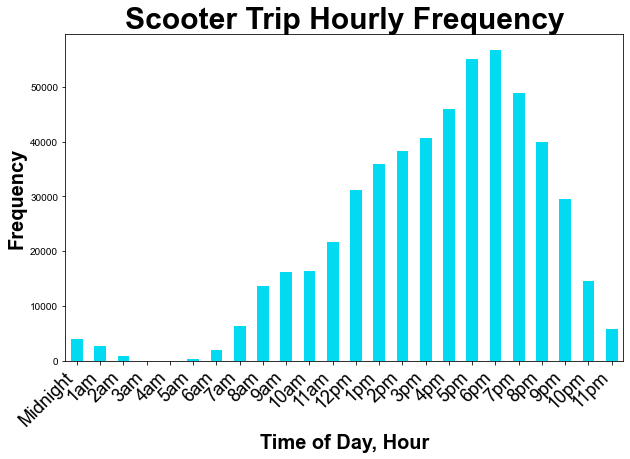

In [27]:
hours=['Midnight', '1am', '2am','3am', '4am','5am', '6am', '7am', '8am', '9am', '10am', '11am', '12pm',
        '1pm', '2pm', '3pm', '4pm', '5pm', '6pm', '7pm', '8pm', '9pm', '10pm', '11pm',]
fig, ax = plt.subplots(figsize=(10,6))
bar_chart(clean, 'Time_of_Day', ax, '#01DAF0', hours,'Scooter Trip Hourly Frequency', 'Time of Day, Hour')
# plt.savefig('../images/full_df_hour.svg', transparent=False, bbox_inches='tight', format='svg', dpi=1200)
# # image_file('images/fulldf_hour_of_day_bar.svg')
plt.savefig('../images/fulldf_hour_of_day_bar.png', transparent=False, bbox_inches='tight')

In [ ]:
hour_day_of_week = scooter.groupby(['Day_of_Week', 'Time_of_Day']).count()
fig, ax = plt.subplots(figsize=(16, 8))
ax = hour_day_of_week['Trip_ID'].plot(kind='line', color='#8624FC')
ax.set_xlabel('Day of Week & Time of Day', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)
ax.set_title('Scooter Trips', fontsize=20)
ax.set_xticklabels(labels=['Sunday, 10pm', 'Monday, Midnight', 'Monday, 9pm', 'Tuesday, 7pm', 
                'Wednesday, 5pm', 'Thursday, 3pm', 'Friday, 1pm', 'Saturday, 10am', 
                'Sunday, 7am', 'Monday, 8am','Tuesday, 6am'],rotation=45, fontsize=12, ha='right');

In [ ]:
chicago_map = folium.Map(location=[41.862548, -87.749163], zoom_start=11)


In [ ]:
origin_heat_map = location_heat_map(scooter, 'Start_Centroid_Latitude', 
                        'Start_Centroid_Longitude', 'Ride Origins')
origin_heat_map = chicago_map.add_child(origin_heat_map)

In [ ]:
origin_heat_map

In [ ]:
chicago_map1 = folium.Map(location=[41.862548, -87.749163], zoom_start=11)
dest_heat_map = location_heat_map(scooter, 'End_Centroid_Latitude', 
                        'End_Centroid_Longitude', 'Ride Destinations')
dest_heat_map = chicago_map1.add_child(dest_heat_map)


In [ ]:
chicago_map1

## Make cleaned dataset for full df

In [ ]:
full_df = pd.read_csv('../data/2019_Scooter_pilot.csv')

In [ ]:
full_df.info()

In [ ]:
# full_df = clean_dataframe(df=scooter, 
#                           drop_col_lst=['Start Census Tract', 'End Census Tract',
#                                           'Start Community Area Number', 'End Community Area Number', 
#                                           'Start Community Area Name', 'End Community Area Name', 
#                                         'Start Centroid Location', 'End Centroid Location'],
#                           date_col_lst=['Start_Time', 'End_Time'],
#                           day_col='Day_of_Week',
#                           hour_col='Time_of_Day',
#                           date_col='Start_Time',
#                           unit_col_1='Trip_Distance',
#                           div_1=1609,
#                           unit_col_2='Trip_Duration',
#                           div_2=60,
#                           filter_col_lst=['Trip_Distance', 'Trip_Duration', 'Trip_Duration'],
#                           thresh_lst=[25, 2, 400])
full_df = drop_cols_update_names(full_df, ['Start Census Tract', 'End Census Tract',
                                          'Start Community Area Number', 'End Community Area Number', 
                                          'Start Community Area Name', 'End Community Area Name', 
                                        'Start Centroid Location', 'End Centroid Location'])
# drop_nans(full_df)
# full_df = cols_to_datetime(full_df, ['Start_Time', 'End_Time'])
# full_df = add_weekday_column(full_df, 'Day_of_Week', ['Start_Time', 'End_Time'])
# full_df = add_hour_column(full_df, 'Time_of_Day', 'Start_Time') 
# full_df = change_col_units(full_df, 'Trip_Distance', 1609)
# full_df = change_col_units(full_df, 'Trip_Duration', 60)
# full_df = filter_out_bad_data(full_df, ['Trip_Distance', 'Trip_Duration', 'Trip_Duration'], [25, 2, 400]).reset_index(drop=True)



In [ ]:
from datetime import datetime as dt

In [ ]:
drop_nans(full_df)
full_df = cols_to_datetime(full_df, ['Start_Time', 'End_Time'])
full_df = add_weekday_column(full_df, 'Day_of_Week','Start_Time')
full_df = add_hour_column(full_df, 'Time_of_Day', 'Start_Time') 
full_df = change_col_units(full_df, 'Trip_Distance', 1609)
full_df = change_col_units(full_df, 'Trip_Duration', 60)

In [ ]:
full_df.describe()

In [ ]:
full_df = full_df[full_df.Trip_Duration > 2]
full_df = full_df[full_df.Trip_Distance >0].reset_index(drop=True)

In [ ]:
full_df = full_df[full_df.Trip_Distance <25].reset_index(drop=True) #no trips over 25 miles
full_df = full_df[full_df.Trip_Duration <480].reset_index(drop=True) #no trips over 8 hours

In [ ]:
full_df.info()

In [ ]:
full_df.to_csv('data/full_clean_scooter.csv')

In [6]:
clean = pd.read_csv('../data/full_clean_scooter.csv')
clean.head()

,Unnamed: 0,Trip_ID,Start_Time,End_Time,Trip_Distance,Trip_Duration,Accuracy,Start_Centroid_Latitude,Start_Centroid_Longitude,End_Centroid_Latitude,End_Centroid_Longitude,Day_of_Week,Time_of_Day
0,0,11d42b99-e839-346c-11d4-2b99e839346c,2019-06-24 19:00:00,2019-06-24 19:00:00,0.569919,5.983333,10,41.894101,-87.763112,41.894101,-87.763112,0,19
1,1,11ed0125-e5b6-6ab6-11ed-0125e5b66ab6,2019-07-13 15:00:00,2019-07-13 15:00:00,0.069608,7.066667,10,41.938666,-87.711211,41.938666,-87.711211,5,15
2,2,1690f90b-0a0a-402d-b493-ed351d7e0946,2019-07-20 18:00:00,2019-07-20 18:00:00,1.072094,19.016667,10,41.938666,-87.711211,41.938666,-87.711211,5,18
3,3,b1a423cc-4544-4edc-9cdf-857a952d98c2,2019-06-30 20:00:00,2019-06-30 21:00:00,0.688005,41.983333,10,41.938666,-87.711211,41.938666,-87.711211,6,20
4,4,123586b2-4ad4-694e-1235-86b24ad4694e,2019-09-06 15:00:00,2019-09-06 16:00:00,1.850218,9.533333,10,41.927261,-87.765502,41.938666,-87.711211,4,15


In [7]:
clean.drop(columns='Unnamed: 0', inplace=True)

cols_to_datetime(clean, ['Start_Time', 'End_Time'])

,Trip_ID,Start_Time,End_Time,Trip_Distance,Trip_Duration,Accuracy,Start_Centroid_Latitude,Start_Centroid_Longitude,End_Centroid_Latitude,End_Centroid_Longitude,Day_of_Week,Time_of_Day
0,11d42b99-e839-346c-11d4-2b99e839346c,2019-06-24 19:00:00,2019-06-24 19:00:00,0.569919,5.983333,10,41.894101,-87.763112,41.894101,-87.763112,0,19
1,11ed0125-e5b6-6ab6-11ed-0125e5b66ab6,2019-07-13 15:00:00,2019-07-13 15:00:00,0.069608,7.066667,10,41.938666,-87.711211,41.938666,-87.711211,5,15
2,1690f90b-0a0a-402d-b493-ed351d7e0946,2019-07-20 18:00:00,2019-07-20 18:00:00,1.072094,19.016667,10,41.938666,-87.711211,41.938666,-87.711211,5,18
3,b1a423cc-4544-4edc-9cdf-857a952d98c2,2019-06-30 20:00:00,2019-06-30 21:00:00,0.688005,41.983333,10,41.938666,-87.711211,41.938666,-87.711211,6,20
4,123586b2-4ad4-694e-1235-86b24ad4694e,2019-09-06 15:00:00,2019-09-06 16:00:00,1.850218,9.533333,10,41.927261,-87.765502,41.938666,-87.711211,4,15
...,...,...,...,...,...,...,...,...,...,...,...,...
526615,e28e355e-b890-5f15-8c82-a09daaa22227,2019-06-20 21:00:00,2019-06-20 21:00:00,0.839652,23.950000,0,41.899507,-87.679600,41.899422,-87.684490,3,21
526616,db29a731-9ab0-5428-8368-bea758cac4fe,2019-07-24 16:00:00,2019-07-24 16:00:00,0.139838,2.450000,0,41.901207,-87.676357,41.901207,-87.676357,2,16
526617,f644d8ce-a32d-5c1c-ad92-ca01ef86b9f9,2019-08-30 16:00:00,2019-08-30 16:00:00,0.369795,5.016667,0,41.899670,-87.669837,41.908376,-87.670937,4,16
526618,fe97d758-f9eb-4314-85c0-058d56019e39,2019-07-06 15:00:00,2019-07-06 15:00:00,0.770044,5.350000,152,41.892433,-87.669624,41.899670,-87.669837,5,15


In [11]:
# clean = cols_to_datetime(clean, ['Start_Time', 'End_Time'])
clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 526620 entries, 0 to 526619
Data columns (total 12 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   Trip_ID                   526620 non-null  object        
 1   Start_Time                526620 non-null  datetime64[ns]
 2   End_Time                  526620 non-null  datetime64[ns]
 3   Trip_Distance             526620 non-null  float64       
 4   Trip_Duration             526620 non-null  float64       
 5   Accuracy                  526620 non-null  int64         
 6   Start_Centroid_Latitude   526620 non-null  float64       
 7   Start_Centroid_Longitude  526620 non-null  float64       
 8   End_Centroid_Latitude     526620 non-null  float64       
 9   End_Centroid_Longitude    526620 non-null  float64       
 10  Day_of_Week               526620 non-null  int64         
 11  Time_of_Day               526620 non-null  int64         
dtypes:

put markers for k means clusters

In [16]:
clusters = [[41.89850811, -87.68202525 ],
 [  41.89707314, -87.7083582 ],
 [  41.9014501,  -87.69171184  ],
 [  41.89119501, -87.69458118 ],
 [  41.90068024, -87.70085826 ]]
clust = [[  41.89850804, -87.68202525,  41.89857512, -87.68218175],
 [ 41.89707314, -87.7083582,   41.89785375, -87.70850408],
 [ 41.90067972, -87.70085794,  41.90148862,  -87.70168626 ],
 [  41.90145037, -87.69171128,  41.90213863,  -87.69257839 ],
 [41.89119501, -87.69458118,  41.89213592,  -87.69679821 ]]
clust1 = [[  41.90067306, -87.70025203 ],
 [ 41.90115895, -87.6885474 ],
 [41.89554754, -87.71025266 ],
 [ 41.89124841, -87.69717353 ],
 [41.90167075, -87.69459988 ],
 [41.89406379, -87.69114063],
 [41.89717146, -87.68070732  ],
 [41.89950474, -87.70586366 ],
 [41.89884809, -87.6818932]]

In [18]:
kmeans_clust_df = pd.DataFrame(data=clust1, columns=['lat', 'lon'])
name = ['cluster ' + str(idx + 1) for idx in range(0, len(kmeans_clust_df))]
kmeans_clust_df['name'] = name
kmeans_clust_df

,lat,lon,name
0,41.900673,-87.700252,cluster 1
1,41.901159,-87.688547,cluster 2
2,41.895548,-87.710253,cluster 3
3,41.891248,-87.697174,cluster 4
4,41.901671,-87.694600,cluster 5
5,41.894064,-87.691141,cluster 6
6,41.897171,-87.680707,cluster 7
7,41.899505,-87.705864,cluster 8
8,41.898848,-87.681893,cluster 9


In [ ]:
clust_df = pd.DataFrame(data=clust, columns=['start_lat', 'start_lon', 'end_lat', 'end_lon'])
name = ['cluster ' + str(idx + 1) for idx in range(0, len(clust_df))]
clust_df['name'] = name
clust_df

In [15]:
import folium
chicago_map = folium.Map(location=[41.88955765, -87.71819668], zoom_start=11)


In [19]:
for i, row in kmeans_clust_df.iterrows():
    folium.Marker([row['lat'], row['lon']], popup=row['name'], color='b').add_to(chicago_map)
    

chicago_map

In [21]:
from folium.plugins import HeatMap
heat_map = folium.FeatureGroup(name = 'heat_map')
heat_map.add_child( HeatMap( list(zip(clean['Start_Centroid_Latitude'].values,
                                      clean['Start_Centroid_Longitude'].values)),
                            name='Origins',
                            max_val=float(60),
                   min_opacity=0.2,
                   radius=5.5, blur=3.5, 
                   max_zoom=1, 
                 ))
chicago_map.add_child(heat_map)

In [ ]:
chicago_map1 = folium.Map(location=[41.88955765, -87.71819668], zoom_start=11)


In [ ]:
for i, row in clust_df.iterrows():
    folium.Marker([row['start_lat'], row['start_lon']], popup=row['name'], color='b').add_to(chicago_map1)
    

chicago_map1

In [ ]:
from folium.plugins import HeatMap
heat_map = folium.FeatureGroup(name = 'heat_map')
heat_map.add_child( HeatMap( list(zip(full_df['Start_Centroid_Latitude'].values,
                                      full_df['Start_Centroid_Longitude'].values)),
                            name='Origins',
                            max_val=float(60),
                   min_opacity=0.2,
                   radius=5.5, blur=3.5, 
                   max_zoom=1, 
                 ))
chicago_map1.add_child(heat_map)

In [ ]:
chicago_map2 = folium.Map(location=[41.88955765, -87.71819668], zoom_start=11)


In [ ]:
for i, row in clust_df.iterrows():
    folium.Marker([row['end_lat'], row['end_lon']], popup=row['name'], color='b').add_to(chicago_map2)
    

chicago_map2

In [ ]:
from folium.plugins import HeatMap
heat_map = folium.FeatureGroup(name = 'heat_map')
heat_map.add_child( HeatMap( list(zip(full_df['End_Centroid_Latitude'].values,
                                      full_df['End_Centroid_Longitude'].values)),
                            name='Origins',
                            max_val=float(60),
                   min_opacity=0.2,
                   radius=5.5, blur=3.5, 
                   max_zoom=1, 
                 ))
chicago_map2.add_child(heat_map)

In [8]:
clean.drop(columns=['Trip_ID', 'Start_Time', 'End_Time', 'Accuracy', 'End_Centroid_Latitude',
            'End_Centroid_Longitude'], inplace=True)

In [9]:
clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 526620 entries, 0 to 526619
Data columns (total 6 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Trip_Distance             526620 non-null  float64
 1   Trip_Duration             526620 non-null  float64
 2   Start_Centroid_Latitude   526620 non-null  float64
 3   Start_Centroid_Longitude  526620 non-null  float64
 4   Day_of_Week               526620 non-null  int64  
 5   Time_of_Day               526620 non-null  int64  
dtypes: float64(4), int64(2)
memory usage: 24.1 MB


In [ ]:
clust_1 = hierarchical_cluster_model('euclidean', 'complete',
                                                clean)

In [14]:
kmeans = kmeans_model(clean, n_clust=9)
print('cluster centers:{}'.format(kmeans.cluster_centers_))

cluster centers:[[  3.65408695  39.30351301  41.90067306 -87.70025203   3.32116634
   16.24925868]
 [  1.73348429  13.68623271  41.90115895 -87.6885474    3.26366254
   16.48719295]
 [  4.63055163 107.538406    41.89554754 -87.71025266   3.21268865
   15.83510341]
 [  4.2274572  185.02868269  41.89124841 -87.69717353   3.11615487
   15.79305741]
 [  2.71146318  24.11377645  41.90167075 -87.69459988   3.33329952
   15.90996246]
 [  2.94874602 337.8893864   41.89406379 -87.69114063   3.30845771
   14.10945274]
 [  0.84368816   5.8154659   41.89717146 -87.68070732   3.06724214
   10.7163274 ]
 [  3.96090546  64.9341719   41.89950474 -87.70586366   3.26899653
   16.10709266]
 [  0.73814197   5.57613738  41.89884809 -87.6818932    2.92715862
   18.11377432]]


In [ ]:
kmeans = kmeans_model(clean, n_clust=5)
print('cluster centers:{}'.format(kmeans.cluster_centers_))